In [1]:
# Imports
import numpy as np
import pandas as pd

# Visualization libraries
from matplotlib import pyplot as plt
from matplotlib import animation
from statistics import variance as var
%matplotlib inline
from IPython.display import HTML

# Proprietary scripts
from data_sources import StockDataGenerator, synthetic_coin_generator
from regime_change_utils import log_likelihood, RegimeChangeAnimator, detect_regime_change

# Using MDL to detect Regime Changes in Stock Price Movements
---

## Summary
Originally, this project was a Homework Project for _CME240 - Statistical and Machine Learning Approaches to Problems in Investment Management_, taught by Jeremy Evnine at the [Stanford Institute for Computational & Mathematical Engineering (ICME)](https://icme.stanford.edu/) in Spring 2019. 

The goal is to **detect regime changes** in stock price movements. The approach is to model the underlying up- and downward movements as a **binary random variable**, propose a **binomial mixture model** and determine the breakpoint in the observed time series that maximizes the quality of the fit. In a **stylized experiment on data from a simulated coin**, the model picks up a regime change with a latency of 5 periods. Applied to the **S&P 500 between 2008 and 2009**, the model suggests a regime change around June 12th, 2008 - just about two months before the financial meltdown coupled in Lehman Brother's collapse.

---

## General modelling approach: A Binomial Mixture Model
The underlying idea for this class project _(CME240 - Statistical and Machine Learning Approaches to Problems in Investment Management)_ was to use the concept of **Minimum Description Length** (MDL) to quickly **detect regime changes in stock price movements**. Using MDL, the daily **upward/downward fluctuation of stock prices** is modelled as a **binary random variable** (RV). Based on this modelling approach, regime changes are detected by comparing the fit of a **single- vs. a binomial mixture model** to an observed time series. By virtue of MDL, a regime change is proposed whenever a **binomial mixutre model** acheives a better fit to the observed data (i.e. a smaller MDL), compared to a **single binomial model**. The intuition of a mixture model (i.e. a combination of two binomial distributions with different chances of success) achieving a better fit than a single binomial distribution is that there appears to be a **break point in the observed time series** at which the chances of upward/downward price fluctuations have changes substantially.

The remainder of this notebook is structured as follows: Before starting with the actual modelling, I will very briefly touch on the theory of MDL and it's origin in Information Theory. Afterwards, I first demonstrate the approach i just described on a **series of synthetically generated coin tosses** for which the two underlying probability regimes are well-known. Afterwards, I use actual stock data (**Name Stock Here**) to challenge the model's applicability in a real-world context.

## Theory background

### Information theory, probability, and the notion of lenght

[Rissanen][1] was the first to propose the concept of Minimum Description Length (MDL) as a mathematically rigorous way of describing the **tradeoff between model complexity and goodness of fit**. On a high level, Rissanen's MDL framework comprises **two components**:

1. A code for encoding a **hypothesis** (i.e. a probability distribution), H, over source sequences: $L(H)$. 
2. A code based on H, to encode the **actual data**: $L(Z \mid H)$.

Both codes in Rissanen's framework carry the **notion of length**. The **negative log-likelihood** of the data (i.e. $-\log P(Z \mid \Theta)$) is usually used as a proxy for the **length of the data**, whereas there is a lot of different ways to mathematically describe the **length of the hypothesis**.

A way to think intuitively about why the negative log-likelyhood is a good way to measure the length of the data stems from Information Theory. In particular, the **information inequality** formulates an optimal bound to the amount of information captured by a probability distribution $P$:

$$\mathbb E_P[-\log Q(Z)] > \mathbb E_P[-\log P(Z)] \forall Q(\cdot) \neq P(\cdot)$$

It can be shown that this inequality holds by virtue of the concavity of the logarithm. More importantly, however, what the inequality tells is that the expected negative log-likelihood (i.e. the entropy) sets a **lower bound to the description lenght of the data**. By virtue of the law of large numbers, lower bound holds in general for large $n$.[2]

When trying to make sense of similar measures to capture the **length of the hypothesis**, things get a lot less intuitive, compared to measuring lenght of the data. However, [Rissanen(1984)][3] argue that:

> The mean code length is bounded from below by the mean information, given by the expression $- \log P(Z) + \frac{k}{2} \log n$, for
“practically all” processes defined by $\Theta = \{\theta_1, \dots, \theta_k\}$ 
-- [Rissanen(1984) pp. 630][3] 

By adding $\frac{k}{2} \log n$ to the negative log-likelihood, Rissanen's expression add as a **penalty for more complex families of hypotheses**. I.e. the more parameters $\Theta = \{\theta_1, \dots, \theta_k\}$ there are to describe a chosen set of hyposeses, the higher the penalty. Hence, Rissanen's expression perfectly **incorporates the tradeoff between godness of fit and model complexity**.

### MDL for Binomial Mixture Models

The general form of MDL is given as:
$$\mathcal L_{\min} = - \log P(Z) + \frac{k}{2} \log n$$

For a mixture of two binomial distributions with breakpoint $m$, we have:
$$s_1 = \sum_{i=1}^m X_i$$
$$s_2 = \sum_{i=m+1}^n X_i$$

$$\mathcal L_{\min} = - \log \left(p_1^{s_1}(1-p_1)^{k-s_1} \right)\left(p_2^{s_2}(1-p_2)^{n-k-s_2}\right) + \frac{1}{2}\log(m) + \frac{1}{2}\log(n-m)$$
$$\mathcal L_{\min} = - \left(s_1 \log (p_1) + (m-s_1)\log(1-p_1)\right) - \left(s_2 \log (p_2) + (n-m-s_2) \log (1-p_2)\right) + \frac{1}{2}\log(m) + \frac{1}{2}\log(n-m)$$

---
## Simulations

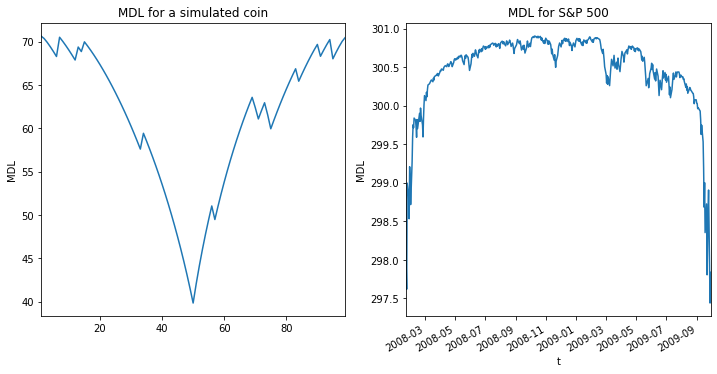

In [2]:
mdl_coin,_ = detect_regime_change(time_series=[i for i in synthetic_coin_generator([0.1, 0.9], 50, 100)], k=1)
mdl_stock,_ = detect_regime_change(*StockDataGenerator("^GSPC").closing_prices("2008-01-20","2009-09-30"), k=1)

f,a = plt.subplots(1,2, figsize=(12,6))

mdl_coin.plot(ax=a[0])
a[0].set_ylabel('MDL')
a[0].set_title("MDL for a simulated coin")

mdl_stock.plot(ax=a[1])
a[1].set_ylabel('MDL')
a[1].set_xlabel('t')
a[1].set_title("MDL for S&P 500")

plt.show()

### Acting on MDL to detect changes in probability regimes

The two charts above present a good example for why **it is anything but straighforward to identify changes in a probability regime using MDL**. When looking at those two charts in hindsight, it is fairly easy to pinpoint the MDL-minimizing breakpoint accross the entire time series. In realty, however, one can obviously not foresee the future to determine whether any given MDL is already the global minimum, or whether there will be an even better point in time to set the MDL-minimizing breakpoint.

Hence, in the simulations below, the following protocol is used to reliably determine the MDL-minimizing breakpoint in a real-world simulation setting:

1. Spikes and high MDL-fluctuations cause regime change detection to become extremely volatile - this volatility is mitigated by **"smoothing" (i.e. exponential moving average)**
2. Judging the breakpoint by virtue of a global minimum favors the tails of the time series - this poblem is mitigated by using a sliding window to act on **local, instead of global minima**

### Regime change detection using a simulated coin

For the simulation below, a series of 100 draws from a biased coin is being generated.Tthe **bias of the coin changes after the first 50 draws**. 
Hence, we already know that the regime change we want to detect occured around t=50. When you play the video short, you'll see how the **detection algorithm observes the time series step-py-step** and how it determines an optimal breakpoint in the probability regime by following the above protocol. In this stylized coin setting, the algorithm is able to identify the change in the underlying probability regime just 5 steps after it actually occured.

In [15]:
%%capture
np.random.seed(123)
mdl_coin, regime_change_date = detect_regime_change(time_series=[i for i in synthetic_coin_generator([0.1, 0.9], 50, 100)], 
                                                    k=0.9, stride=4)
animator = RegimeChangeAnimator(mdl_coin, regime_change_date)

In [16]:
HTML(animator.animate().to_jshtml())

### Regime change detection for the S&P 500

This time, the simulation is run by observing a series of up- and downward movements in **S&P 500 closing prices between Jan 2008 and Sept 2009**. The algorithm suggests a regime change around June 12th, 2018 - just about two months before the financial meltdown coupled in Lehman Brother's collapse.

In [22]:
%%capture
mdl_sp500, regime_change_date = detect_regime_change(*StockDataGenerator(symbol="^GSPC").closing_prices("2008-01-20","2009-09-30"), k=0.05, stride=6)
closing_prices,_ = StockDataGenerator(symbol="^GSPC").closing_prices("2008-01-20","2009-09-30", real=True)
html_rendering = RegimeChangeAnimator(mdl_sp500, regime_change_date, closing_prices).animate().to_jshtml()

In [23]:
HTML(html_rendering)